In [1]:
#install.packages(c("tm","wordcloud","XML","proxy","SnowballC"))
library(tm)
library(wordcloud)
library(proxy)
library(XML)
library(SnowballC)


#install.packages(c("foreach","doParallel"))
library(foreach)
library(doParallel)

Loading required package: NLP
Warning message:
: package 'wordcloud' was built under R version 3.2.5Loading required package: RColorBrewer
Warning message:
: package 'proxy' was built under R version 3.2.5
Attaching package: 'proxy'

The following objects are masked from 'package:stats':

    as.dist, dist

The following object is masked from 'package:base':

    as.matrix

Warning message:
: package 'foreach' was built under R version 3.2.5Warning message:
: package 'doParallel' was built under R version 3.2.5Loading required package: iterators
Loading required package: parallel


In [7]:
#SourceFolder="Datos IoT"
#SourceFolder="TestHTML"
SourceListHTML=list.files(path=SourceFolder);summary(SourceListHTML)

file=0
report=data.frame(text=NULL, status=NULL)
for (text in SourceListHTML){
    file=file+1
    report[file,"text"]=text
    tryCatch({
        DocSourceHTML= htmlTreeParse(paste(SourceFolder,text, sep="/"),useInternal = TRUE)
        DocText = unlist(xpathApply(DocSourceHTML, '//p', xmlValue))
        DocText = gsub('\\n', ' ',DocText)
        DocText = paste(DocText, collapse = ' ')
        #DocText = unlist(strsplit(DocText, " "))
        #print("___TEXTO DESCARGADO___");print(DocText)
        #DocText_remove <- grep("DocText", iconv(DocText, "latin1", "ASCII", sub=""))
        #print("___A ELIMINAR___");print(DocText_remove)
        #DocText = DocText[!DocText %in% DocText_remove]
        #DocText = paste(DocText, collapse = ' ')
        DocText= removeWords(DocText, stopwords("english"))
        DocText= stemDocument(DocText)
        DocText= tolower(DocText)
        DocText= removePunctuation(DocText)
        DocText= stripWhitespace(DocText)
        DocText= removeNumbers(DocText)
        DocText= gsub("[[:punct:]]", " ", DocText)
        DocText= gsub("[^[:alnum:] ]", " ", DocText)
        #print("___TEXTO FINAL___");print(DocText)
        if (nchar(DocText)>1){
            write(as.character(DocText),file=paste("TextResults/",text,".txt",sep=""))#,fileEncoding = "UTF-8")
            #print (paste("File:",file,"|| ",text,"|| Processed"))
            report[file,"status"]= "Processed"
        }else{
            #print (paste("File:",file,"|| ",text,"|| Empty"))
            report[file,"status"]= "Empty"
            }
        },error=function(e){
            #print (paste("File:",file,"|| ",text,"|| ERROR"))
            report[file,"status"]= "Error"
        })
    }
table(report$status)

   Length     Class      Mode 
      245 character character 


    Empty Processed 
       25       217 

## Parallel processing foreach R
https://beckmw.wordpress.com/2014/01/21/a-brief-foray-into-parallel-processing-with-r/


In [4]:
install.packages (c("foreach","doParallel"))
library(foreach)
library(doParallel)    

Installing packages into 'C:/Users/Alexis/Documents/R/win-library/3.2'
(as 'lib' is unspecified)
Warning message:
: packages 'foreach', 'doParallel' are in use and will not be installed

###  Loop foreach

In [5]:
#import packages
library(foreach)
library(doParallel)
     
#number of iterations
iters<-1e2
 
#setup parallel backend to use 8 processors
cl<-makeCluster(4)
registerDoParallel(cl)
 
#start time
strt<-Sys.time()

#file=0
report=data.frame(text=NULL, status=NULL) 

#loop
ls<-foreach(icount(iters)) %dopar% {
    file=file+1
    report[file,"text"]=text
    tryCatch({
        DocSourceHTML= htmlTreeParse(paste(SourceFolder,text, sep="/"),useInternal = TRUE)
        DocText = unlist(xpathApply(DocSourceHTML, '//p', xmlValue))
        DocText = gsub('\\n', ' ',DocText)
        DocText = paste(DocText, collapse = ' ')
        #DocText = unlist(strsplit(DocText, " "))
        #print("___TEXTO DESCARGADO___");print(DocText)
        #DocText_remove <- grep("DocText", iconv(DocText, "latin1", "ASCII", sub=""))
        #print("___A ELIMINAR___");print(DocText_remove)
        #DocText = DocText[!DocText %in% DocText_remove]
        #DocText = paste(DocText, collapse = ' ')
        DocText= removeWords(DocText, stopwords("english"))
        DocText= stemDocument(DocText)
        DocText= tolower(DocText)
        DocText= removePunctuation(DocText)
        DocText= stripWhitespace(DocText)
        DocText= removeNumbers(DocText)
        DocText= gsub("[[:punct:]]", " ", DocText)
        DocText= gsub("[^[:alnum:] ]", " ", DocText)
        #print("___TEXTO FINAL___");print(DocText)
        if (nchar(DocText)>1){
            write(as.character(DocText),file=paste("TextResults/",text,".txt",sep=""))#,fileEncoding = "UTF-8")
            #print (paste("File:",file,"|| ",text,"|| Processed"))
            report[file,"status"]= "Processed"
        }else{
            #print (paste("File:",file,"|| ",text,"|| Empty"))
            report[file,"status"]= "Empty"
            }
        },error=function(e){
            #print (paste("File:",file,"|| ",text,"|| ERROR"))
            report[file,"status"]= "Error"
        })
    }
table(report$status)

 
print(Sys.time()-strt)
stopCluster(cl)
 

ERROR: Error in {: task 1 failed - "objeto de tipo 'closure' no es subconjunto"


< table of extent 0 >

Time difference of 0.5030191 secs


## TF-IDF

In [57]:
rm(list = ls())

#Crear corpus
corpus <- Corpus(DirSource("TextResults"))

#Matriz td-idf
terms <-DocumentTermMatrix(corpus,control = list(weighting = function(x) weightTfIdf(x, normalize=TRUE)))
#Documentos
length(rownames(terms))
#Terminos
length(colnames(terms))

#Distancia coseno
cos_simil <-as.matrix(simil(dtm_matrix, method="cosine"))




[1] 200

[1] 1333

Warning message:
In weightTfIdf(x, normalize = TRUE): empty document(s): AntiTitForTat 2.html.txt AntiTitForTat.html.txt Application 3.html.txt application.html.txt ApplicationListItem.html.txt arcgis 2.html.txt arcgis 3.html.txt arcgis 4.html.txt arcgis.html.txt AreaManagerCoverPresence.html.txt AreaManagerManagingDragItems.html.txt AreaManagerRegistering.html.txt ArgGenerator 2.html.txt ArgGenerator.html.txt ArrayListListModel 2.html.txt ArrayListListModel.html.txt ASCIIFormatter 2.html.txt

[1] 200

[1] 1333

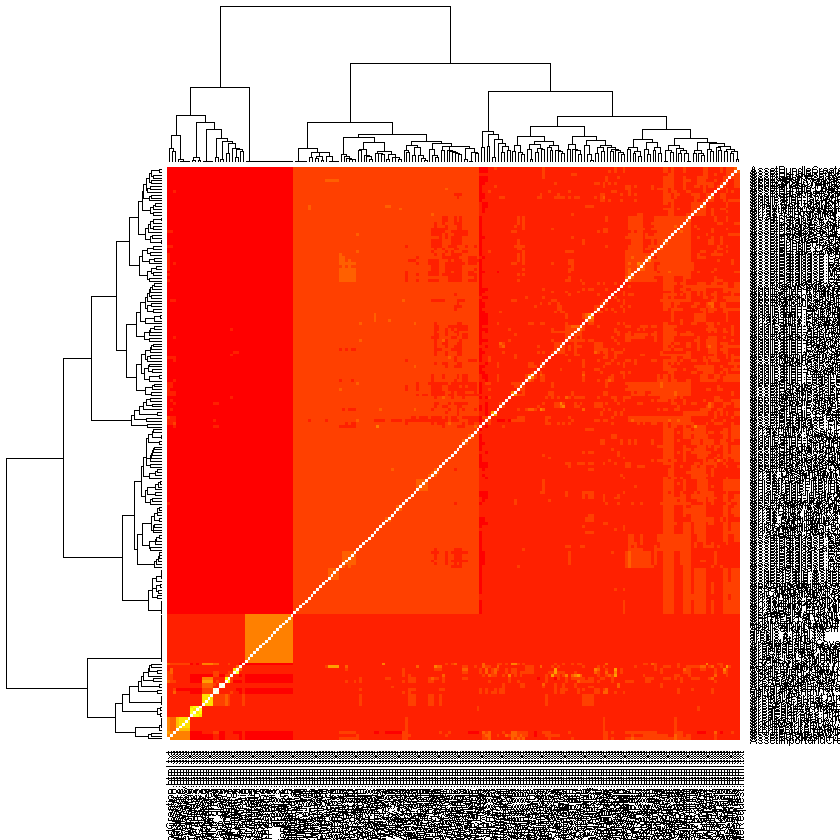

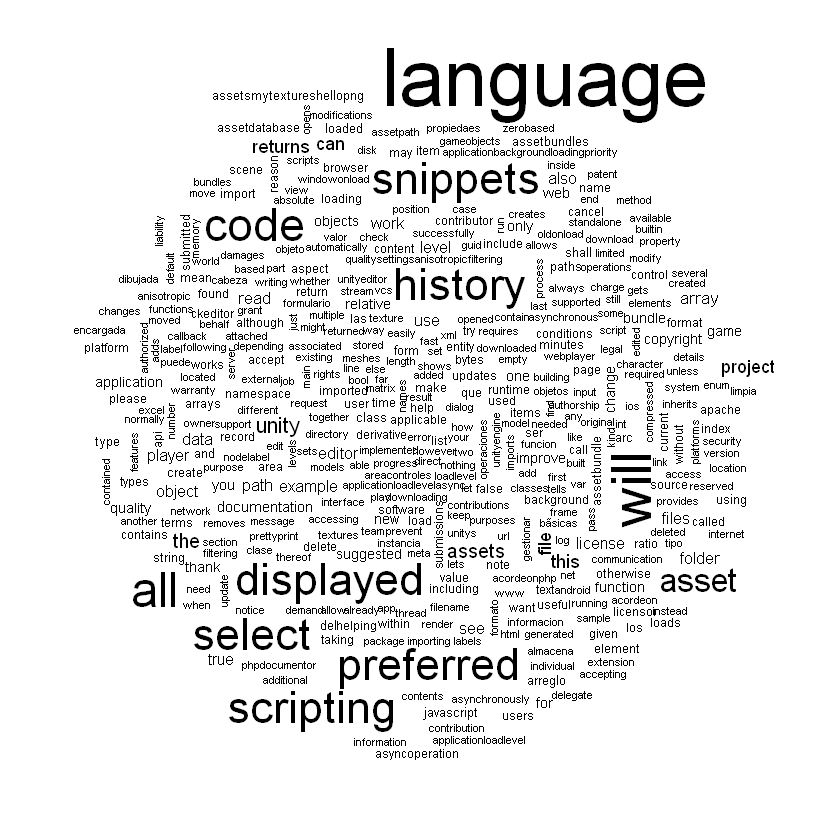

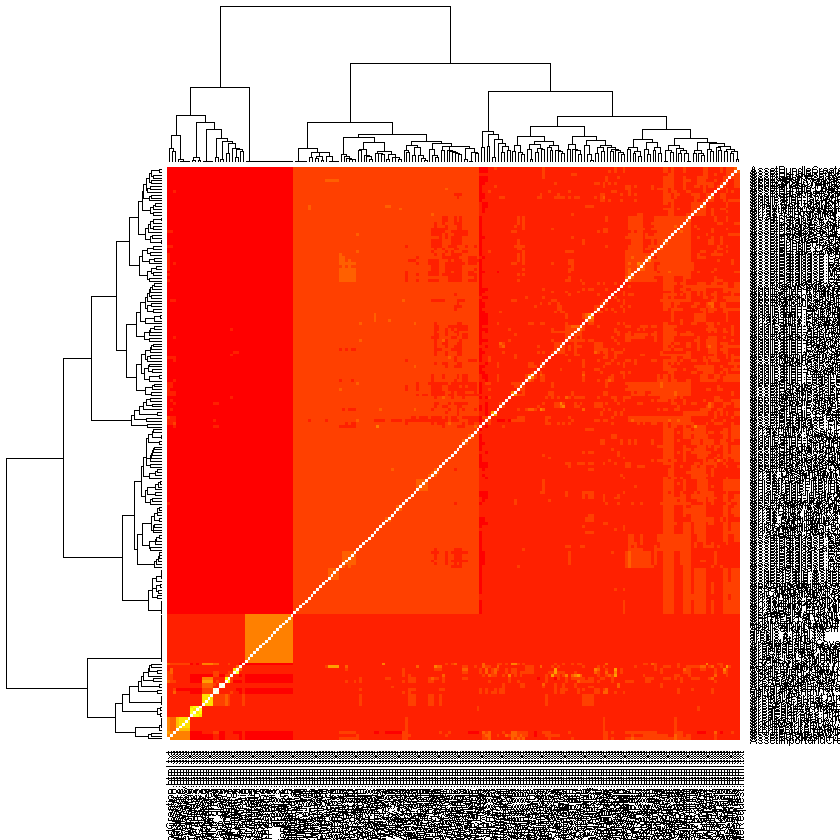

In [59]:
#Terminos mas frecuentes
frequency_terms<-(colSums(dtm_matrix)) 
frequency_decr<-sort(frequency_terms, decreasing=T)

#Matriz td-idf
terms <-DocumentTermMatrix(corpus,control = list(weighting = function(x) weightTfIdf(x, normalize=TRUE)))
#Documentos
length(rownames(terms))
#Terminos
length(colnames(terms))

#Distancia coseno
cos_simil <-as.matrix(simil(dtm_matrix, method="cosine"))

#Visualizacion de la distancia coseno
heatmap(cos_simil[1:length(rownames(terms)),1:length(rownames(terms))])
#dev.copy(jpeg,filename="heatmap_test_1.jpg")

# wordCloud  
words<-names(frequency_decr)# head(words)
#X11()
wordcloud(words[1:500],frequency_decr[1:length(colnames(terms))])
# Export JPG _ mode 1 # maximize window, better this one
#dev.copy(jpeg,filename="wordCloud_test_1.jpg")
#dev.off ()